## Flow/Speed/Occupancy Clustering for I-5 South

In [1]:
%matplotlib inline

In [2]:
import pandas as pd
import numpy as np
import gzip
import datetime as dt
from os import listdir
from os.path import isfile, join
import time
import itertools

from operator import itemgetter 

import matplotlib.pyplot as plt

from sklearn import cluster
from sklearn.neighbors import kneighbors_graph
from sklearn.cross_validation import train_test_split
from sklearn.metrics import confusion_matrix

import sys
sys.path.append('../')

import c2utils.timer as timer

In [3]:
data_path = '../../data/'
data_file = data_path + 'I5S_data2.csv'

output_path = 'I5S-graphs/'

In [5]:
def count_bad_sensors(df):
    count_nan_df = df
    count_nan_df.loc[:,'Station'] = count_nan_df['Station'].astype(str)
    count_nan_df = count_nan_df[['Station','Timestamp','TotalFlow','AvgOccupancy','AvgSpeed']]
    num = count_nan_df._get_numeric_data()
    num[num > 0] = 0
    count_nan_df=count_nan_df.replace(np.nan,1)
    count_nan_df=count_nan_df.groupby('Station').sum().reset_index()
    count_nan_df.loc[:,'Total'] = count_nan_df['TotalFlow']+count_nan_df['AvgOccupancy']+count_nan_df['AvgSpeed']
    count_nan_df=count_nan_df.sort_values('Total')
    return count_nan_df

In [6]:
def calc_avg_obs(df):
    count_nan_df = df
    count_nan_df['Station'] = count_nan_df['Station'].astype(str)
    count_nan_df = count_nan_df[['Station','% Observed']]
    count_nan_df=count_nan_df.groupby('Station').mean().reset_index()
    return count_nan_df

### Load data

In [4]:
colnames = ['Idx', 'Date', 'Time', 'Station', 'District', 'Freeway #', 'Direction', 'Lane Type', 'Station Length',
                     'Samples', '% Observed', 'TotalFlow', 'AvgOccupancy', 'AvgSpeed', 'Lat', 'Lon', 'Order']

t0 = time.time()
df = pd.read_csv( data_file, header=None, skiprows=1 )
df.columns = colnames

df.drop( ['District', 'Freeway #', 'Direction', 'Lane Type', 
       'Station Length', 'Samples', '% Observed', 'Lat', 'Lon', 'Idx'], 
        axis=1, inplace=True)

print timer.timestr( time.time()-t0 )

df.shape

23.39 sec


(10773178, 7)

In [5]:
df.head()

,Date,Time,Station,TotalFlow,AvgOccupancy,AvgSpeed,Order
0,01/01/2015,00:00:00,1108417,76.0,0.0125,69.6,73
1,01/01/2015,00:05:00,1108417,92.0,0.0150,69.2,73
2,01/01/2015,00:10:00,1108417,100.0,0.0162,69.8,73
3,01/01/2015,00:15:00,1108417,91.0,0.0143,69.9,73
4,01/01/2015,00:20:00,1108417,176.0,0.0291,67.6,73


In [5]:
df.columns.tolist()

['Date', 'Time', 'Station', 'TotalFlow', 'AvgOccupancy', 'AvgSpeed', 'Order']

### Plotting Function

In [6]:
colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 20)

def plot_cluster( df, title, y_pred, to_file=None ):
    fig = plt.figure(figsize = (20,5))
    plt.title( title, {'fontsize': 20})

    ax1 = fig.add_subplot(1, 3, 1)
    ax2 = fig.add_subplot(1, 3, 2)
    ax3 = fig.add_subplot(1, 3, 3)

    ax1.scatter( df['AvgOccupancy'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    ax2.scatter( df['TotalFlow'], df['AvgOccupancy'], color=colors[y_pred].tolist(), s=10 )
    ax3.scatter( df['TotalFlow'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )

    #ax1.set_xlim( (0, 0.2)), ax1.set_ylim( (40, 75))
    #ax2.set_xlim( (0, 600)), ax2.set_ylim( (0, 0.7))
    #ax3.set_xlim( (0, 600)), ax3.set_ylim( (40, 75))
    
    ax1.set_xlabel('AvgOccupancy'), ax1.set_ylabel('AvgSpeed')
    ax2.set_xlabel('TotalFlow'), ax2.set_ylabel('AvgOccupancy')
    ax3.set_xlabel('TotalFlow'), ax3.set_ylabel('AvgSpeed')

    if to_file != None:
        fig.savefig( output_path + 'birch_clusters/'+ to_file ) 
    else:
        plt.show()
    plt.close( fig )

### Standardize

In [8]:
station = df.Station.unique()[0]
ordinal = df[ df.Station==station ].Order.unique()[0]

t0 = time.time()
X_orig = df[ df.Station==station ][['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
X = (X_orig - X_orig.mean())/X_orig.std()

print timer.timestr(time.time()-t0)
X.shape

0.16 sec


(104789, 3)

In [ ]:
# randomly sample if we need to have a smaller dataset
'''
sample_size = 0.05

X_orig, _ = train_test_split( X_orig, train_size=sample_size, random_state=42 )
print 'shape:', X_orig.shape

X = (X_orig - X_orig.mean())/X_orig.std()
'''

### Cluster each station
Set `create_graphs` to `True` in order to produce graphs and write them out to directory.
<b style='color:blue'>Note: creating graphs takes approx 30 min.</b>

In [ ]:
create_graphs = False

Progress: |█████████-----------------------------------------| 18.4% Complete [6.05 min]

/Users/monkey/anaconda/envs/capstone/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Progress: |██████████████████████████████████████████████████| 99.0% Complete [31.76 min]

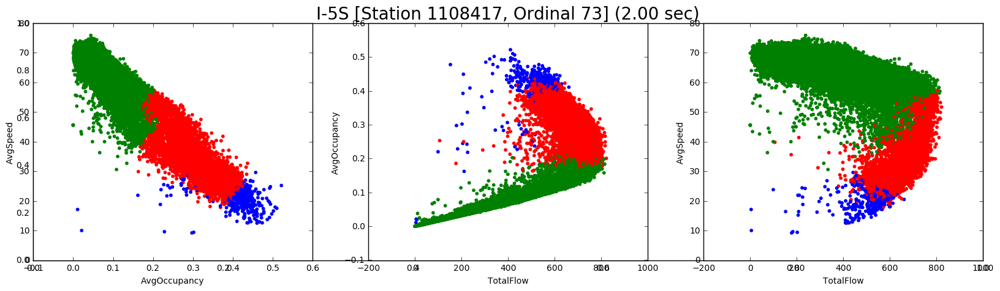

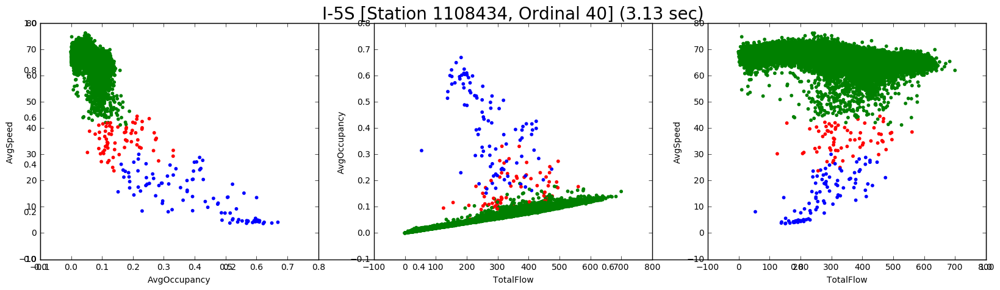

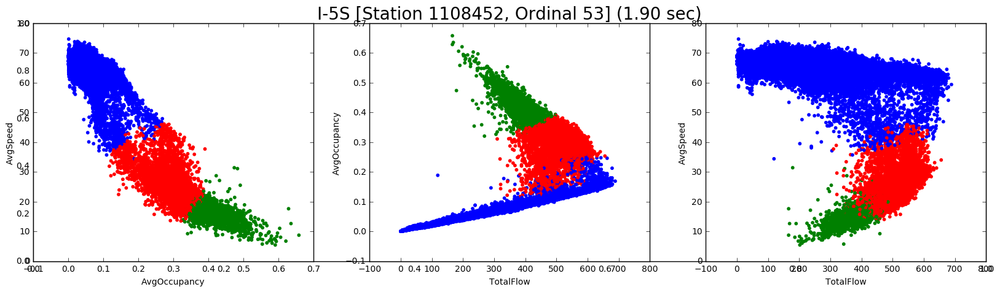

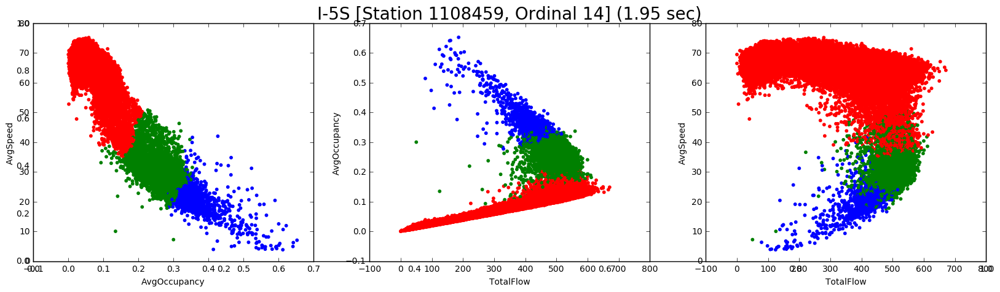

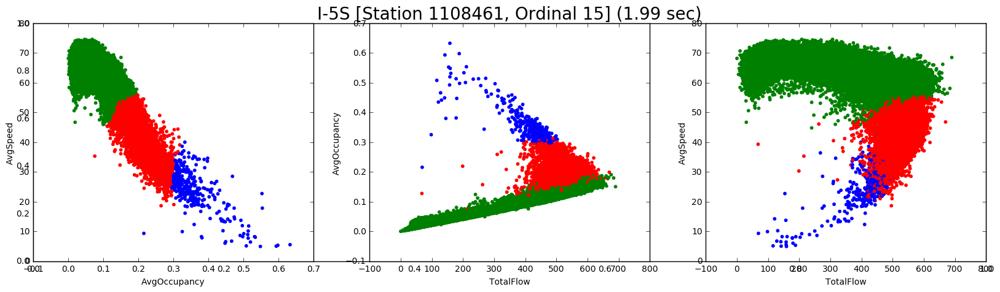

...

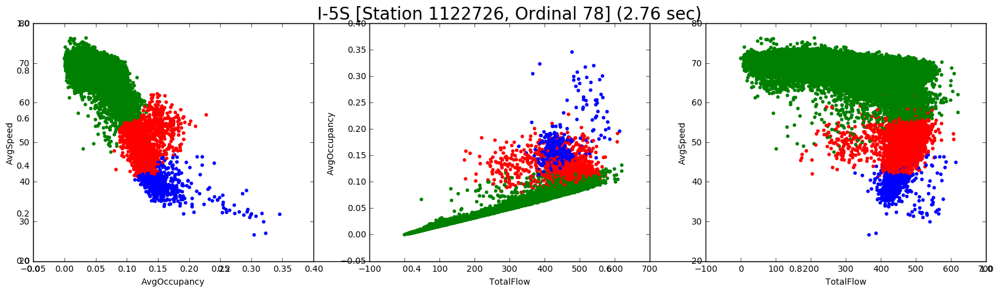

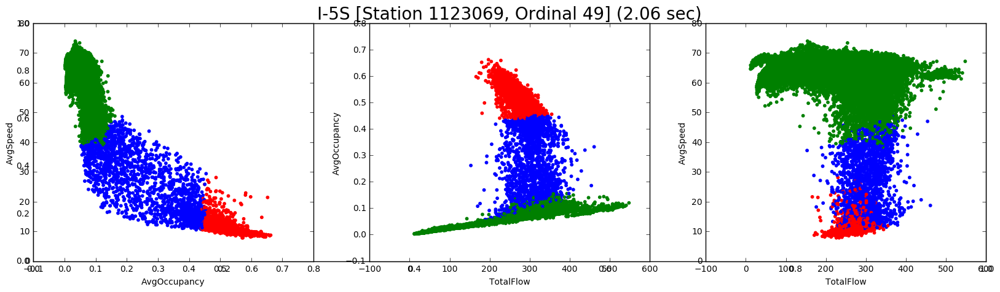

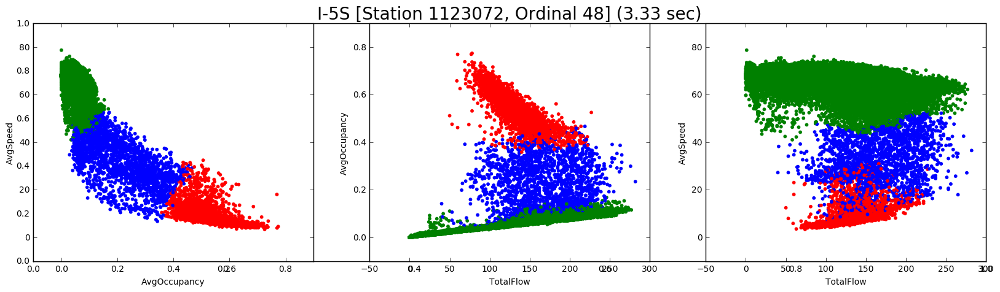

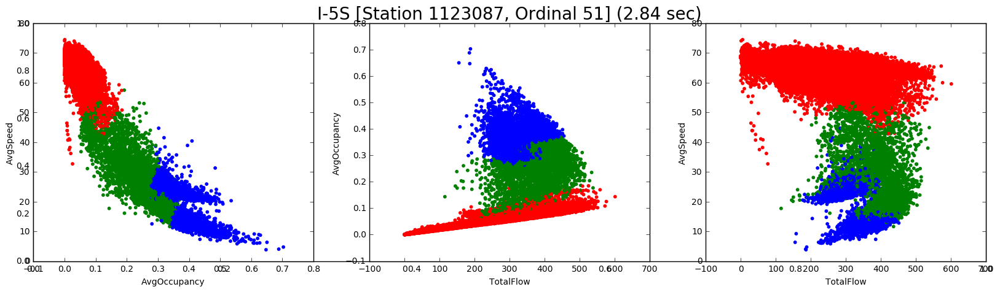

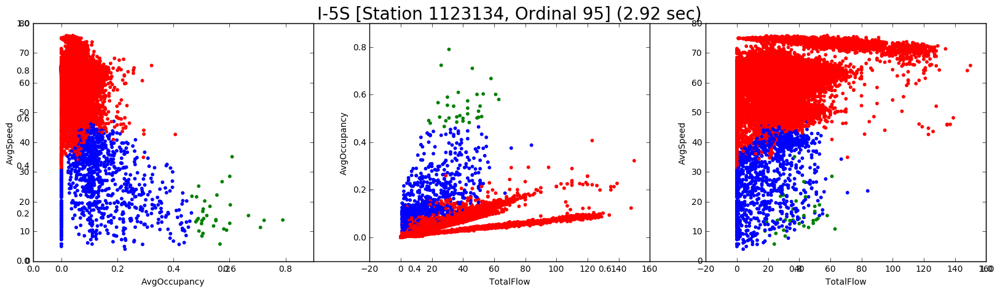

In [27]:
stations = df.Station.unique()

pb = timer.ProgressBar( len(stations), prefix='Progress:', suffix='Complete', timer=True )

for i, station in enumerate(stations):
    ordinal = df[ df.Station==station ].Order.unique()[0]
    
    X_orig = df[ df.Station==station ][['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
    X = (X_orig - X_orig.mean())/X_orig.std()   #Standardize prior to clustering

    birch = cluster.Birch( n_clusters=3 )

    t0 = time.time()
    y_pred = birch.fit_predict( X )
    
    if create_graphs == True:
        title = 'I-5S [Station {0}, Ordinal {1}] ({2:.2f} sec)'.format( station, ordinal, time.time()-t0 )
        fname = '{}_I5S_{}.png'.format( ordinal, station )
        plot_cluster( X_orig, title, y_pred, to_file=fname )
    
    pb.update( i )

# Uh oh
## The clusters look terrible!!

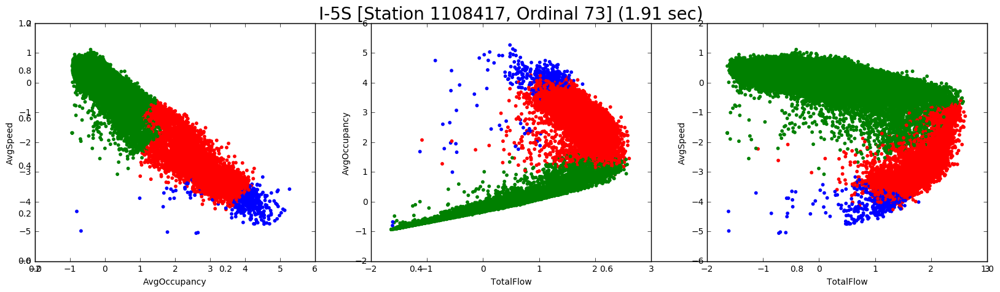

In [11]:
birch = cluster.Birch( n_clusters=3 )

t0 = time.time()
y_pred = birch.fit_predict( X )
title = 'I-5S [Station {0}, Ordinal {1}] ({2:.2f} sec)'.format( station, ordinal, time.time()-t0 )
fname = '{}_I5S_{}.png'.format( ordinal, station )

plot_cluster( X, title, y_pred )

### Find which labels are associated with each traffic type
Each run of the cluster algo comes up with a different set of labels.

eg. clustering of station xxxx says label 1 is 'jam', 2 is 'almost', and 0 is 'normal'.  However, clustering of station yyyy says label 1 is 'normal', 2 is 'jam', and 0 is 'almost'

Nobody agrees!!

Possible approach:
1. Come up with a representative set of data points for each type:

| flow | occ | speed | type |
|------|-----|-------|------|
| 300  | 0.5 | 10    | jam  |
| 400  | 0.2 | 40    | almost |
| 50   | 0.05| 70    | normal |
2. Use the model created for each station to predict these fake data points.
3. ???
4. Profit

In [15]:
test_df = pd.DataFrame( 
    [[300, 0.5, 10, 'jam'], 
     [400, 0.2, 40, 'almost'], 
     [50, 0.05, 70, 'normal']],
    columns=['TotalFlow', 'AvgOccupancy', 'AvgSpeed', 'Desc'] )

X = test_df[['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]

test_df

,TotalFlow,AvgOccupancy,AvgSpeed,Desc
0,300,0.50,10,jam
1,400,0.20,40,almost
2,50,0.05,70,normal


In [16]:
station = df.Station.unique()[14]
X_orig = df[ df.Station==station ][['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
X = (X_orig - X_orig.mean())/X_orig.std()

birch = cluster.Birch( n_clusters=3 )
y_pred = birch.fit_predict( X )

#plot_cluster( X, 'Standardized, Station {}'.format(station), y_pred )

#plot_cluster( X_orig, 'Original, Station {}'.format(station), y_pred )

X = (test_df[['TotalFlow', 'AvgOccupancy', 'AvgSpeed']] - X_orig.mean())/X_orig.std()

y_pred = birch.predict( X )
#plot_cluster( X, 'Test Label Dataframe', y_pred )

tdf = pd.concat([test_df, pd.Series(y_pred, name='Label')], axis=1)
tdf.rename( columns={'Label':str(station)}, inplace=True )
tdf

,TotalFlow,AvgOccupancy,AvgSpeed,Desc,1108605
0,300,0.50,10,jam,0
1,400,0.20,40,almost,1
2,50,0.05,70,normal,2


In [101]:
dfs = []

stations = df.Station.unique()
pb = timer.ProgressBar( len(stations), prefix='Progress:', suffix='Complete', timer=True )

for i, station in enumerate(stations):
    ordinal = df[ df.Station==station ].Order.unique()[0]
    X_orig = df[ df.Station==station ][['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
    X = (X_orig - X_orig.mean())/X_orig.std()

    birch = cluster.Birch( n_clusters=3 )
    y_pred = birch.fit_predict( X )

    X = (test_df[['TotalFlow', 'AvgOccupancy', 'AvgSpeed']] - X_orig.mean())/X_orig.std()

    y_pred = birch.predict( X )

    tdf = pd.concat([test_df, pd.Series(y_pred, name='Label')], axis=1)
    lbl = '{}-{}'.format(ordinal, station)
    tdf.rename( columns={'Label':lbl}, inplace=True )
    dfs.append( tdf.set_index('Desc')[lbl] )
    
    pb.update(i)

len(dfs)

Progress: |██████████████████████████████████████████████████| 99.0% Complete [4.59 min]]

103

In [102]:
perms = ['012', '021', '102', '120', '210', '201']  # valid permutations

tdf = pd.concat(dfs, axis=1).T
tdf.loc[:,'signature'] = tdf.apply( lambda x: '{}{}{}'.format(x[0],x[1],x[2]), axis=1 )
tdf.loc[tdf.signature.isin(perms),'fail'] = False
tdf.loc[~tdf.signature.isin(perms),'fail'] = True
tdf.reset_index().groupby('fail').index.nunique()

fail
False    80
True     23
Name: index, dtype: int64

In [109]:
tdf[tdf.fail==True][['jam', 'almost', 'normal']]

Desc,jam,almost,normal
30-1108475,1,0,0
29-1108477,1,0,0
18-1108560,1,0,0
58-1114283,0,1,1
75-1114318,2,0,0
96-1114735,2,2,1
63-1114806,0,0,2
64-1115355,2,0,0
98-1118365,0,0,2
97-1118372,1,1,0


## Centroids!

In [17]:
station = df.Station.unique()[14]
X_orig = df[ df.Station==station ][['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
X = (X_orig - X_orig.mean())/X_orig.std()

birch = cluster.Birch( n_clusters=3 )
y_pred = birch.fit_predict( X )

In [18]:
birch.subcluster_centers_, birch.subcluster_labels_

(array([[-1.24431873, -0.7228643 ,  0.48190295],
        [ 0.06286186, -0.21713629,  0.33257061],
        [ 0.90536147,  0.12754415,  0.13952057],
        [ 1.12015378,  3.08929731, -2.91294534],
        [ 0.52068136,  3.93718812, -3.8091514 ],
        [ 1.22624888,  2.65064177, -3.20780038],
        [ 1.56488969,  0.78819177, -1.23791324],
        [ 1.19895285,  0.36816685, -0.44655916],
        [ 1.48872285,  0.40716807, -0.0392324 ],
        [ 1.4886522 ,  2.13029322, -2.7833307 ],
        [ 1.65199603,  1.23980646, -2.14779166],
        [ 1.86408152,  1.31821586, -1.2380668 ],
        [ 0.86623622,  3.29995847, -3.56820625],
        [ 1.59567577,  2.00231043, -2.01656989],
        [ 0.40782795,  4.12001633, -2.45844394],
        [ 0.24139923,  1.92861254, -1.79324885],
        [-0.24625872,  3.54183785, -2.18127932],
        [-0.07305173,  5.20788751, -4.11745187],
        [ 0.29053522,  4.4675845 , -3.95126025],
        [ 1.87263976,  0.70208861, -0.40930271],
        [ 0.61702387

In [7]:
colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 20)

def plot_cluster_with_centroids( df, cdf, title, y_pred, to_file=None ):
    fig = plt.figure(figsize = (20,5))
    plt.title( title, {'fontsize': 20})

    ax1 = fig.add_subplot(1, 3, 1)
    ax2 = fig.add_subplot(1, 3, 2)
    ax3 = fig.add_subplot(1, 3, 3)

    ax1.scatter( df['AvgOccupancy'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    ax2.scatter( df['TotalFlow'], df['AvgOccupancy'], color=colors[y_pred].tolist(), s=10 )
    ax3.scatter( df['TotalFlow'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    
    y_cent = cdf.index.tolist()
    ax1.scatter( cdf['AvgOccupancy'], cdf['AvgSpeed'], facecolor='y', s=200, edgecolor='k', linewidth=2, marker=(5, 1) )
    ax2.scatter( cdf['TotalFlow'], cdf['AvgOccupancy'], facecolor='y', s=200, edgecolor='k', linewidth=2, marker=(5, 1) )
    ax3.scatter( cdf['TotalFlow'], cdf['AvgSpeed'], facecolor='y', s=200, edgecolor='k', linewidth=2, marker=(5, 1) )
    
    ax1.set_xlabel('AvgOccupancy'), ax1.set_ylabel('AvgSpeed')
    ax2.set_xlabel('TotalFlow'), ax2.set_ylabel('AvgOccupancy')
    ax3.set_xlabel('TotalFlow'), ax3.set_ylabel('AvgSpeed')

    if to_file != None:
        fig.savefig( output_path + 'birch_clusters/'+ to_file ) 
    else:
        plt.show()
    plt.close( fig )

In [8]:
def get_centroids( birch_model ):
    subcentroids = zip( birch_model.subcluster_centers_, birch_model.subcluster_labels_ )
    subcentroids = map( lambda x: (x[1], x[0][0], x[0][1], x[0][2]), subcentroids)
    sdf = pd.DataFrame( subcentroids ).rename( columns={0:'Label', 1:'TotalFlow', 2:'AvgOccupancy', 3:'AvgSpeed'} )
    return sdf.groupby('Label').mean()

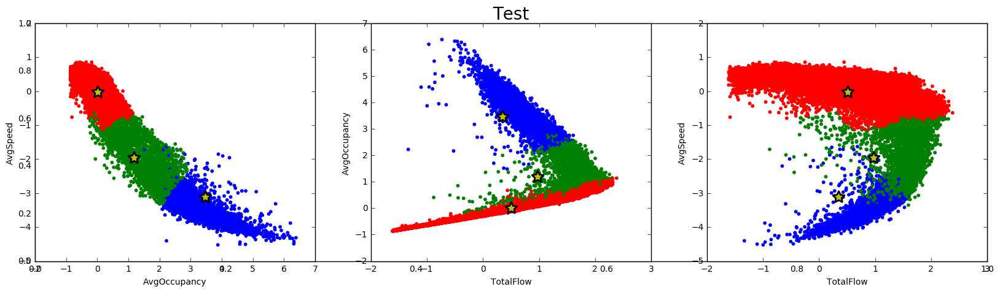

In [68]:
sdf = get_centroids( birch )

plot_cluster_with_centroids( X, sdf, 'Test', y_pred )

# CLUSTERS 2: Electric Boogaloo, Let's Get Heuristic

### New approach:
1. Forget Birch (at least for now)
2. Use speed to designate thresholds for classes:
    - speed < 25 == jam
    - speed > 55 == normal
    - 25 > speed < 55 == semi-jam
3. Classify the data
4. Create triple+one graphs (the usual 3 plus a % points per label) for each station

In [192]:
jamd = {0:'normal', 1:'semi-jam', 2:'jam'}

colors = np.array([x for x in 'gbr'])
colors = np.hstack([colors] * 20)

def plot_quartet( df, title, to_file=None ):
    y_pred = df.Label.tolist()
    fig = plt.figure(figsize = (25,5))
    plt.title( title, {'fontsize': 20})

    ax1 = fig.add_subplot(1, 4, 1)
    ax2 = fig.add_subplot(1, 4, 2)
    ax3 = fig.add_subplot(1, 4, 3)
    ax4 = fig.add_subplot(1, 4, 4)

    ax1.scatter( df['AvgOccupancy'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    ax2.scatter( df['TotalFlow'], df['AvgOccupancy'], color=colors[y_pred].tolist(), s=10 )
    ax3.scatter( df['TotalFlow'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    
    sizes = df.Label.value_counts().tolist()
    labelidx = df.Label.unique().tolist()
    labels = itemgetter(*labelidx)(jamd.values())
    piecolors = ['g', 'b', 'r']
    ax4.pie(sizes, labels=labels, radius=0.5,
        autopct='%1.1f%%', startangle=90, colors=piecolors)
    ax4.axis('equal')
    
    ax1.set_xlabel('AvgOccupancy'), ax1.set_ylabel('AvgSpeed')
    ax2.set_xlabel('TotalFlow'), ax2.set_ylabel('AvgOccupancy')
    ax3.set_xlabel('TotalFlow'), ax3.set_ylabel('AvgSpeed')

    if to_file != None:
        fig.savefig( output_path + 'heuristic_classifier/' + to_file ) 
    else:
        plt.show()
    plt.close( fig )

### Perform Heuristic Classification
| speed | desc   | label |
|-------|--------|-------|
| >= 55  | normal | 0     |
| < 55 & > 25 | semi-jam | 1 |
| <= 25  | jam    | 2     |

In [9]:
def speed_to_label( v ):
    return 0 if v >= 55 else 2 if v <= 25 else 1

def label_to_range( v ):
    return 0.0 if v==0 else 0.5 if v==1 else 1.0

In [144]:
ldf = df.copy()
ldf.loc[:,'Label'] = ldf.AvgSpeed.apply( lambda x: speed_to_label(x))
ldf

,Date,Time,Station,TotalFlow,AvgOccupancy,AvgSpeed,Order,Label
0,01/01/2015,00:00:00,1108417,76.0,0.0125,69.6,73,0
1,01/01/2015,00:05:00,1108417,92.0,0.0150,69.2,73,0
2,01/01/2015,00:10:00,1108417,100.0,0.0162,69.8,73,0
3,01/01/2015,00:15:00,1108417,91.0,0.0143,69.9,73,0
4,01/01/2015,00:20:00,1108417,176.0,0.0291,67.6,73,0
5,01/01/2015,00:25:00,1108417,181.0,0.0303,68.0,73,0
6,01/01/2015,00:30:00,1108417,177.0,0.0295,67.7,73,0
7,01/01/2015,00:35:00,1108417,169.0,0.0281,68.8,73,0
8,01/01/2015,00:40:00,1108417,200.0,0.0345,67.7,73,0
9,01/01/2015,00:45:00,1108417,164.0,0.0279,67.1,73,0


### Create plots for heuristic classifier

In [176]:
create_graphs = True

In [201]:
stations = ldf.Station.unique()

pb = timer.ProgressBar( len(stations), prefix='Progress:', suffix='Complete', timer=True )

for i, station in enumerate(stations):
    tdf = ldf[ ldf.Station==station ]
    ordinal = tdf.Order.unique()[0]
    
    if create_graphs == True:
        fname = '{}_I5S_{}.png'.format( ordinal, station )
    else:
        fname = None
    
    if not isfile(output_path + 'heuristic_classifier/' + fname):
        title = 'I-5S [Station {0}, Ordinal {1}]'.format( station, ordinal )
        plot_quartet( tdf, title, to_file=fname )
    
    pb.update( i )

Progress: |██████████████████████████████████████████████████| 99.0% Complete [11.69 min]

### Write labeled stations to output

In [207]:
ldf.loc[:,'Class'] = ldf.Label.apply( lambda x: label_to_range(x))
ldf.drop('Label', axis=1).to_csv( data_path + 'I5S_labeled.csv' )

# CLUSTERS 3: The Clusterf**k

### Approach:
1. Take a representative sample of the current stations (both good and bad)
2. Perform heuristic clustering on each station to establish a baseline
3. Perform hyperparameter tuning of BIRCH to find lowest mean error rate

In [6]:
fig = plt.figure(figsize = (25,5))
ax = fig.add_subplot(1, 4, 1)

In [ ]:
ax.text

In [10]:
def plot_confusion_matrix(cm, ax, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.set_title(title)
    tick_marks = np.arange(len(classes))
    ax.xaxis.set_ticks(tick_marks), ax.xaxis.set_ticklabels(classes, rotation=45)
    ax.yaxis.set_ticks(tick_marks), ax.yaxis.set_ticklabels(classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        ax.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    #plt.tight_layout()
    ax.yaxis.set_label('True label')
    ax.xaxis.set_label('Predicted label')

In [11]:
jamd = {0:'normal', 1:'semi-jam', 2:'jam'}

colors = np.array([x for x in 'gbr'])
colors = np.hstack([colors] * 20)

def plot_with_error( df, title, y_pred, y_true, to_file=None ):
    fig = plt.figure(figsize = (25,5))
    plt.title( title, {'fontsize': 20})

    ax1 = fig.add_subplot(1, 4, 1)
    ax2 = fig.add_subplot(1, 4, 2)
    ax3 = fig.add_subplot(1, 4, 3)
    ax4 = fig.add_subplot(1, 4, 4)

    ax1.scatter( df['AvgOccupancy'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    ax2.scatter( df['TotalFlow'], df['AvgOccupancy'], color=colors[y_pred].tolist(), s=10 )
    ax3.scatter( df['TotalFlow'], df['AvgSpeed'], color=colors[y_pred].tolist(), s=10 )
    
    # Confusion matrix: ax4
    cm = confusion_matrix( y_true, y_pred )
    plot_confusion_matrix( cm, ax4, jamd.values() )
    
    ax1.set_xlabel('AvgOccupancy'), ax1.set_ylabel('AvgSpeed')
    ax2.set_xlabel('TotalFlow'), ax2.set_ylabel('AvgOccupancy')
    ax3.set_xlabel('TotalFlow'), ax3.set_ylabel('AvgSpeed')

    if to_file != None:
        fig.savefig( output_path + 'birch_clusters2/' + to_file )
    else:
        plt.show()
    plt.close( fig )

In [12]:
create_graphs = False

In [13]:
ldf = df.copy()
ldf.loc[:,'Label'] = ldf.AvgSpeed.apply( lambda x: speed_to_label(x))

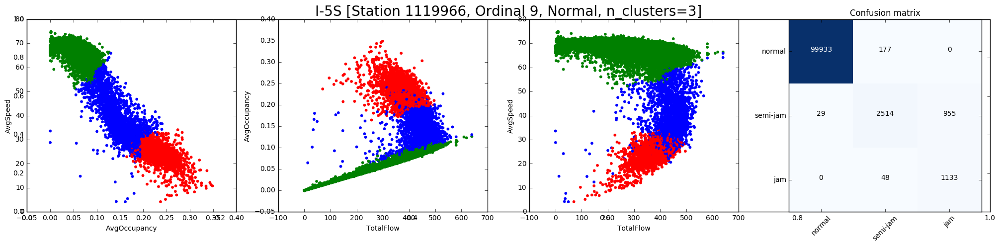

Progress: |--------------------------------------------------| 0.0% Complete [19.35 sec]

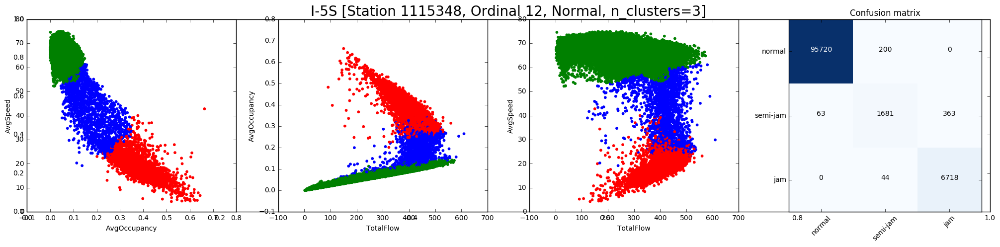

Progress: |█████---------------------------------------------| 10.0% Complete [36.53 sec]

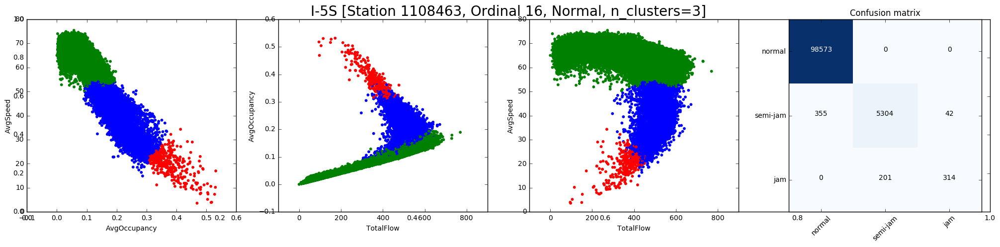

Progress: |██████████----------------------------------------| 20.0% Complete [53.59 sec]

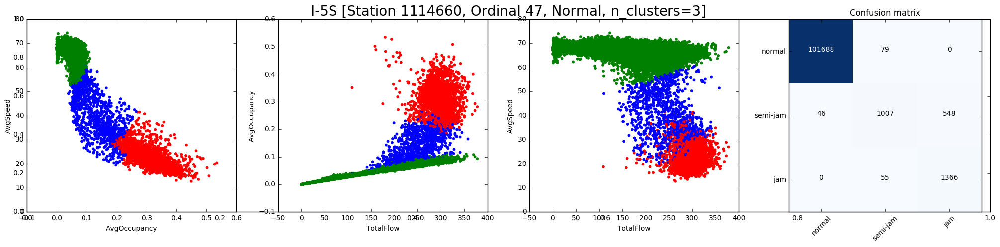

Progress: |███████████████-----------------------------------| 30.0% Complete [1.19 min]

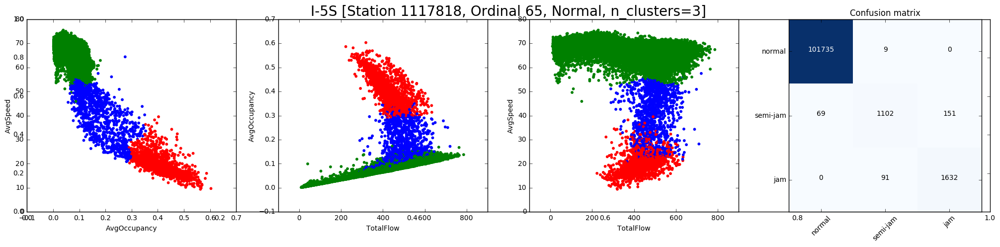

Progress: |████████████████████------------------------------| 40.0% Complete [1.49 min]

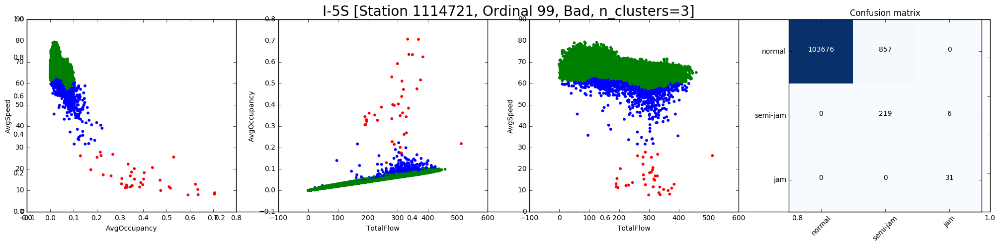

Progress: |█████████████████████████-------------------------| 50.0% Complete [1.79 min]

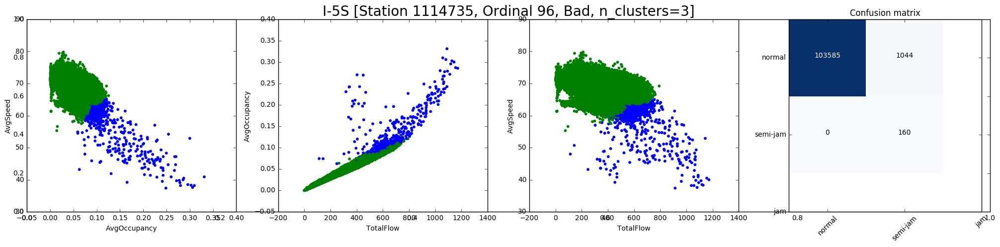

Progress: |██████████████████████████████--------------------| 60.0% Complete [2.10 min]

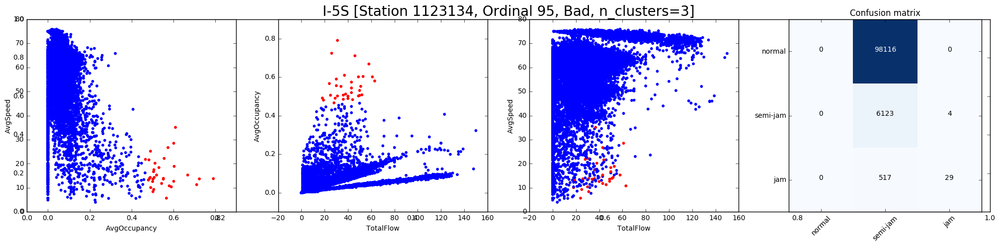

Progress: |███████████████████████████████████---------------| 70.0% Complete [2.42 min]

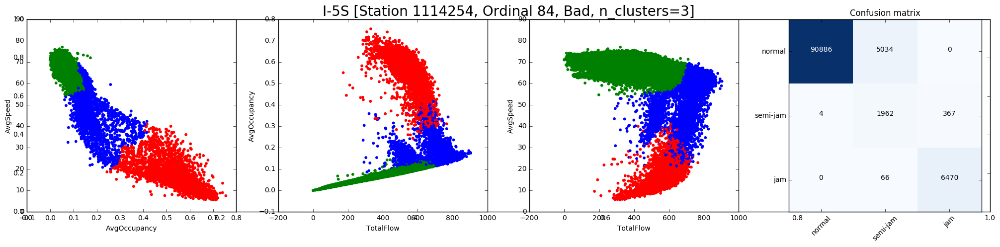

Progress: |████████████████████████████████████████----------| 80.0% Complete [2.69 min]

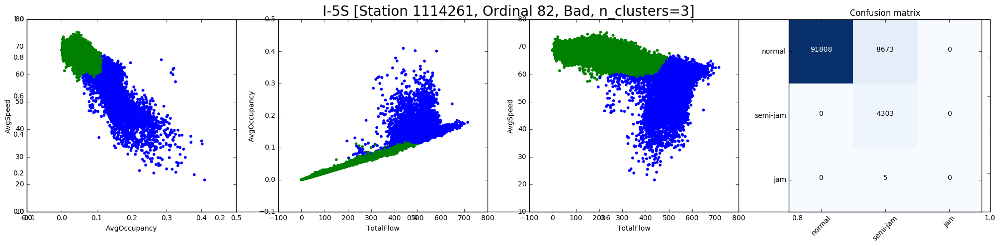

Progress: |█████████████████████████████████████████████-----| 90.0% Complete [3.00 min]

In [14]:
normal_stations = [1119966, 1115348, 1108463, 1114660, 1117818]
bad_stations = [1114721, 1114735, 1123134, 1114254, 1114261]
stations = normal_stations + bad_stations

pb = timer.ProgressBar( len(stations), prefix='Progress:', suffix='Complete', timer=True )

for i, station in enumerate(stations):
    tdf = ldf[ ldf.Station==station ]
    ordinal = tdf.Order.unique()[0]
    stype = 'Normal' if station in normal_stations else 'Bad'
    
    y_true = tdf.Label.tolist()
    
    X_orig = tdf[['TotalFlow', 'AvgOccupancy', 'AvgSpeed']]
    X = (X_orig - X_orig.mean())/X_orig.std()

    paramstr = 'n_clusters=3'
    
    birch = cluster.Birch( n_clusters=3 )
    y_pred = birch.fit_predict( X )
    
    # We need to convert the predicted labels into the label 'basis' used by the heuristic model
    cent_df = get_centroids( birch )
    cent_df = X_orig.mean() + (cent_df * X_orig.std()) # un-standardize
    cent_df.loc[:,'HeuristicLabel'] = cent_df.AvgSpeed.apply( lambda x: speed_to_label(x))
    cent_dict = cent_df.HeuristicLabel.to_dict()
    y_pred = map( lambda x: cent_dict[x], y_pred )
    
    if create_graphs == True:
        fname = '{}_I5S_{}_{}.png'.format( ordinal, station, stype )
    else:
        fname = None
    
    title = 'I-5S [Station {0}, Ordinal {1}, {2}, {3}]'.format( station, ordinal, stype, paramstr )
    plot_with_error( tdf, title, y_pred, y_true, fname )
    
    pb.update( i )

In [77]:
tdf = sdf.copy()
tdf = X_orig.mean() + (tdf * X_orig.std())
tdf.loc[:,'HeuristicLabel'] = tdf.AvgSpeed.apply( lambda x: speed_to_label(x))
print tdf
tdict = tdf['HeuristicLabel'].to_dict()
tdict

        TotalFlow  AvgOccupancy   AvgSpeed  HeuristicLabel
Label                                                     
0      390.918972      0.404917  22.395704               2
1      513.231703      0.191855  37.812926               1
2      421.662120      0.083379  63.893628               0


{0: 2, 1: 1, 2: 0}

In [81]:
zip( y_pred, map( lambda x: tdict[x], y_pred ) )

[(2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 (2, 0),
 